In [1]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) {
    return false;
}

<IPython.core.display.Javascript object>

In [2]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

Run lake detection on multiple images to get an idea of how estimates vary over time, and what variability there is with the estimates
--

In [3]:
import cv2
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib import cm
import numpy as np
import os
import pytz
import datetime
import pandas as pd

%matplotlib inline

In [4]:
def imfdt(imfile):
    #gets a datetime for an image file named like 20180101001002WIWR.jpg
    year = imfile[:4]
    month = imfile[4:6]
    day = imfile[6:8]
    hour = imfile[8:10]
    minute = imfile[10:12]
    second = imfile[12:14]
    dt = pytz.utc.localize(datetime.datetime(int(year), int(month), int(day), int(hour), int(minute), int(second)))
    return (dt)

In [5]:
def innerrect(immask):
    '''find the inner rectangle of the largets area fully contained within an image mask'''
    #based on https://stackoverflow.com/questions/2478447/find-largest-rectangle-containing-only-zeros-in-an-n%C3%97n-binary-matrix
    #need not(mask) to get 0s in lake area mask
    a = cv2.bitwise_not(immask)
    
    nrows = a.shape[0]
    ncols = a.shape[1]

    skip = 255 #image mask so array values are 0 or 255
    area_max = (0, [])

    #zero arrays of same shape as image
    w = np.zeros(dtype=int, shape=a.shape)
    h = np.zeros(dtype=int, shape=a.shape)

    for r in range(nrows):
        for c in range(ncols):
            if a[r][c] == skip:
                continue
            if r == 0:
                h[r][c] = 1
            else:
                h[r][c] = h[r-1][c]+1
            if c == 0:
                w[r][c] = 1
            else:
                w[r][c] = w[r][c-1]+1
            minw = w[r][c]
            for dh in range(h[r][c]):
                minw = min(minw, w[r-dh][c])
                area = (dh+1)*minw
                if area > area_max[0]:
                    area_max = (area, [(r-dh, c-minw+1, r, c)])

    ymin = area_max[1][0][0]
    xmin = area_max[1][0][1]
    ymax = area_max[1][0][2]
    xmax = area_max[1][0][3]
    x_width = xmax - xmin
    y_width = ymax - ymin
    
    return(ymin, xmin, ymax, xmax, x_width, y_width)

In [6]:
def bproj(target, xmin, xmax, ymin, ymax):
    
    threshold = 0

    #crop from image
    model = target[ymin:ymax, xmin:xmax]

    #convert to hsv (hue, saturation, value)
    hsvm = cv2.cvtColor(model,cv2.COLOR_BGR2HSV)

    #calculate histogram of model
    histm = cv2.calcHist([hsvm],[0, 1], None, [180, 256], [0, 180, 0, 256])

    #normalize histogram values to 0-255, this makes it 0-255 x 0-255
    cv2.normalize(histm,histm,0,255,cv2.NORM_MINMAX)
    #apply backprojection
    dst = cv2.calcBackProject([hsvt],[0,1],histm,[0,180,0,256],1)

    #convolute with circular disc
    disc = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(5,5))
    dst = cv2.filter2D(dst,-1,disc,dst)

    #threshold and binary AND
    ret,thresh = cv2.threshold(dst,threshold,255,0)
    thresh = cv2.merge((thresh,thresh,thresh))
    res = cv2.bitwise_and(target,thresh) #get colour from image to show as result

    #apply morphological closing to the lake, to remove gaps inside https://docs.opencv.org/3.0-beta/doc/py_tutorials/py_imgproc/py_morphological_ops/py_morphological_ops.html
    #kernel is 20x20, experimental
    kernel = np.ones((20,20),np.uint8)
    result = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel)
    
    #how many pixels in the detected lake area?
    #grey version
    threshg = cv2.cvtColor(result, cv2.COLOR_BGR2GRAY)

    #histogram of this
    hist = cv2.calcHist([threshg],[0],None,[256],[0,256])

    #number of white pixels, lake pixels are white so last element of array
    whtpx = float(hist[255])
                   
    return(whtpx, result)

In [7]:
def plotonimg(image):
    '''plot image contour (lake boundary) on original image'''
    
    #convert 
    threshg = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    #make a mask from the grey threshold image
    ret, mask = cv2.threshold(threshg, 10, 255, cv2.THRESH_BINARY) #actual threshold value not critical in this case?
    
    #set opacity based on the threshold image using the mask, so can plot lake area on image without covering the background
    b_channel, g_channel, r_channel = cv2.split(result)
    alpha_channel = mask
    thresh_BGRA = cv2.merge((b_channel, g_channel, r_channel, alpha_channel))
    
    #determine boundary of the mask as a contour, so can plot on image
    im2, contours, hierarchy = cv2.findContours(mask,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE)
    
    #find the largest contour, as there might be more than one
    areas = [cv2.contourArea(c) for c in contours]
    max_index = np.argmax(areas)
    cnt=contours[max_index]
    
    #plot it
    RGBimg = cv2.cvtColor(target, cv2.COLOR_BGR2RGB)
    fig,ax = plt.subplots(figsize=(10,5))
    ax.imshow(RGBimg)
    x = [a[0][0] for a in cnt]
    y = [a[0][1] for a in cnt]
    ax.plot(x,y, color='white')
    
    outdir = os.path.join(imgdir,base)
    plt.savefig(outdir+'_lakeoutline.jpg')
    
    ht = estht(cnt, 400)
    
    return (ht)

In [8]:
def estht(contour, xpt):
    '''estimate lake height at a specific point from a lake boundary contour'''
    #xpt may not have a contour value, so use a range
    x1 = xpt - 20
    x2 = xpt + 20
    
    c = np.squeeze(contour) #drop any unused array dimensions

    #find rows having appropriate values
    rows = np.where((c>x1) & (c<x2) ) #returns arrays of row numbers
    rows = rows[0]
    
    #height is mean value for the rows
    ht = np.mean(c[rows][:,1])
    
    return(ht)

**program parameters**

In [9]:
imgdir = '/home/ruma/geonet/volcam_images/backproj_sample_data'

maxiter = 8 #maximum number of iterations
maxinc = 2.0 #maximum area increment between iterations
maxdim = 0.5 #maximum permitted fraction of image dimension 

#initial crop area
x1 = 275
x2 = 350
y1 = 200
y2 = 275
# x1 = 300
# x2 = 325
# y1 = 250
# y2 = 275

**process each image**

20180301000003WIWR.jpg
iter =  0  area =  48853.0
iter =  1  area =  76556.0
area ratio = 1.57
76556.0 76556.0
iter =  2  area =  161610.0
**area too large, ignoring this image**

20180301001002WIWR.jpg
iter =  0  area =  50225.0
iter =  1  area =  59811.0
area ratio = 1.19
59811.0 59811.0
iter =  2  area =  114879.0
**area too large, ignoring this image**

20180301002002WIWR.jpg
iter =  0  area =  53667.0
iter =  1  area =  54697.0
area ratio = 1.02
54697.0 54697.0
iter =  2  area =  54697.0
area ratio = 1.00
**backing up**
iter =  1  area =  54697.0

adding to dataframe
20180301003003WIWR.jpg
iter =  0  area =  52203.0
iter =  1  area =  66358.0
area ratio = 1.27
66358.0 66358.0
iter =  2  area =  137593.0
**area too large, ignoring this image**

20180301004002WIWR.jpg
iter =  0  area =  55477.0
iter =  1  area =  86393.0
area ratio = 1.56
86393.0 86393.0
iter =  2  area =  165163.0
**area too large, ignoring this image**

20180301005002WIWR.jpg
iter =  0  area =  53174.0
iter =  1  

iter =  2  area =  50406.0
area ratio = 1.09
50406.0 50406.0
iter =  3  area =  54086.0
area ratio = 1.07
54086.0 54086.0
iter =  4  area =  53492.0
area ratio = 0.99
**backing up**
iter =  3  area =  54086.0

adding to dataframe
20180303014002WIWR.jpg
iter =  0  area =  42800.0
iter =  1  area =  50709.0
area ratio = 1.18
50709.0 50709.0
iter =  2  area =  52414.0
area ratio = 1.03
52414.0 52414.0
iter =  3  area =  53771.0
area ratio = 1.03
53771.0 53771.0
iter =  4  area =  53771.0
area ratio = 1.00
**backing up**
iter =  3  area =  53771.0

adding to dataframe
20180303015002WIWR.jpg
iter =  0  area =  51276.0
iter =  1  area =  53703.0
area ratio = 1.05
53703.0 53703.0
iter =  2  area =  53074.0
area ratio = 0.99
**backing up**
iter =  1  area =  53703.0

adding to dataframe
20180304000003WIWR.jpg
iter =  0  area =  50280.0
iter =  1  area =  53709.0
area ratio = 1.07
53709.0 53709.0
iter =  2  area =  53834.0
area ratio = 1.00
53834.0 53834.0
iter =  3  area =  55321.0
area ratio 

/home/ruma/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


iter =  1  area =  53963.0
area ratio = 1.11
53963.0 53963.0
iter =  2  area =  54105.0
area ratio = 1.00
54105.0 54105.0
iter =  3  area =  54105.0
area ratio = 1.00
**backing up**
iter =  2  area =  54105.0

adding to dataframe
20180304002002WIWR.jpg
iter =  0  area =  51266.0
iter =  1  area =  54193.0
area ratio = 1.06
54193.0 54193.0
iter =  2  area =  54193.0
area ratio = 1.00
**backing up**
iter =  1  area =  54193.0

adding to dataframe
20180304003003WIWR.jpg
iter =  0  area =  42893.0
iter =  1  area =  51822.0
area ratio = 1.21
51822.0 51822.0
iter =  2  area =  54267.0
area ratio = 1.05
54267.0 54267.0
iter =  3  area =  54371.0
area ratio = 1.00
54371.0 54371.0
iter =  4  area =  54371.0
area ratio = 1.00
**backing up**
iter =  3  area =  54371.0

adding to dataframe
20180304004003WIWR.jpg
iter =  0  area =  52676.0
iter =  1  area =  54037.0
area ratio = 1.03
54037.0 54037.0
iter =  2  area =  54394.0
area ratio = 1.01
54394.0 54394.0
iter =  3  area =  54394.0
area ratio 

iter =  2  area =  51439.0
area ratio = 1.04
51439.0 51439.0
iter =  3  area =  52989.0
area ratio = 1.03
52989.0 52989.0
iter =  4  area =  53022.0
area ratio = 1.00
53022.0 53022.0
iter =  5  area =  53022.0
area ratio = 1.00
**backing up**
iter =  4  area =  53022.0

adding to dataframe
20180309002002WIWR.jpg
iter =  0  area =  47423.0
iter =  1  area =  53200.0
area ratio = 1.12
53200.0 53200.0
iter =  2  area =  56086.0
area ratio = 1.05
56086.0 56086.0
iter =  3  area =  57901.0
area ratio = 1.03
57901.0 57901.0
iter =  4  area =  57901.0
area ratio = 1.00
**backing up**
iter =  3  area =  57901.0

adding to dataframe
20180309003002WIWR.jpg
iter =  0  area =  43897.0
iter =  1  area =  52885.0
area ratio = 1.20
52885.0 52885.0
iter =  2  area =  54077.0
area ratio = 1.02
54077.0 54077.0
iter =  3  area =  55336.0
area ratio = 1.02
55336.0 55336.0
iter =  4  area =  55463.0
area ratio = 1.00
55463.0 55463.0
iter =  5  area =  55686.0
area ratio = 1.00
55686.0 55686.0
iter =  6  ar

iter =  3  area =  65956.0
area ratio = 1.00
**backing up**
iter =  2  area =  65956.0

adding to dataframe
20180313001002WIWR.jpg
iter =  0  area =  56921.0
iter =  1  area =  59855.0
area ratio = 1.05
59855.0 59855.0
iter =  2  area =  59855.0
area ratio = 1.00
**backing up**
iter =  1  area =  59855.0

adding to dataframe
20180313002002WIWR.jpg
iter =  0  area =  57105.0
iter =  1  area =  61184.0
area ratio = 1.07
61184.0 61184.0
iter =  2  area =  61184.0
area ratio = 1.00
**backing up**
iter =  1  area =  61184.0

adding to dataframe
20180313003002WIWR.jpg
iter =  0  area =  57085.0
iter =  1  area =  60873.0
area ratio = 1.07
60873.0 60873.0
iter =  2  area =  60873.0
area ratio = 1.00
**backing up**
iter =  1  area =  60873.0

adding to dataframe
20180313004002WIWR.jpg
iter =  0  area =  58798.0
iter =  1  area =  61042.0
area ratio = 1.04
61042.0 61042.0
iter =  2  area =  61042.0
area ratio = 1.00
**backing up**
iter =  1  area =  61042.0

adding to dataframe
20180313005002WI

iter =  2  area =  59160.0
area ratio = 1.01
59160.0 59160.0
iter =  3  area =  60276.0
area ratio = 1.02
60276.0 60276.0
iter =  4  area =  62900.0
area ratio = 1.04
62900.0 62900.0
iter =  5  area =  68681.0
area ratio = 1.09
68681.0 68681.0
iter =  6  area =  72510.0
area ratio = 1.06
72510.0 72510.0
iter =  7  area =  83542.0
area ratio = 1.15
83542.0 83542.0

adding to dataframe
20180315012002WIWR.jpg
iter =  0  area =  52918.0
iter =  1  area =  58240.0
area ratio = 1.10
58240.0 58240.0
iter =  2  area =  58301.0
area ratio = 1.00
58301.0 58301.0
iter =  3  area =  58301.0
area ratio = 1.00
**backing up**
iter =  2  area =  58301.0

adding to dataframe
20180315013002WIWR.jpg
iter =  0  area =  49690.0
iter =  1  area =  58113.0
area ratio = 1.17
58113.0 58113.0
iter =  2  area =  64163.0
area ratio = 1.10
64163.0 64163.0
iter =  3  area =  107025.0
**area too large, ignoring this image**

20180315014002WIWR.jpg
iter =  0  area =  57421.0
iter =  1  area =  57949.0
area ratio = 1.

/home/ruma/anaconda3/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2957: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/ruma/anaconda3/lib/python3.6/site-packages/numpy/core/_methods.py:80: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


iter =  1  area =  53339.0
area ratio = 1.26
53339.0 53339.0
iter =  2  area =  56842.0
area ratio = 1.07
56842.0 56842.0
iter =  3  area =  57769.0
area ratio = 1.02
57769.0 57769.0
iter =  4  area =  58039.0
area ratio = 1.00
58039.0 58039.0
iter =  5  area =  58038.0
area ratio = 1.00
**backing up**
iter =  4  area =  58039.0

adding to dataframe
20180317011002WIWR.jpg
iter =  0  area =  50663.0
iter =  1  area =  56228.0
area ratio = 1.11
56228.0 56228.0
iter =  2  area =  56123.0
area ratio = 1.00
**backing up**
iter =  1  area =  56228.0

adding to dataframe
20180317012002WIWR.jpg
iter =  0  area =  48285.0
iter =  1  area =  55840.0
area ratio = 1.16
55840.0 55840.0
iter =  2  area =  58563.0
area ratio = 1.05
58563.0 58563.0
iter =  3  area =  58832.0
area ratio = 1.00
58832.0 58832.0
iter =  4  area =  60585.0
area ratio = 1.03
60585.0 60585.0
iter =  5  area =  62138.0
area ratio = 1.03
62138.0 62138.0
iter =  6  area =  63484.0
area ratio = 1.02
63484.0 63484.0
iter =  7  ar

iter =  1  area =  61081.0
area ratio = 1.23
61081.0 61081.0
iter =  2  area =  64436.0
area ratio = 1.05
64436.0 64436.0
iter =  3  area =  65842.0
area ratio = 1.02
65842.0 65842.0
iter =  4  area =  83284.0
area ratio = 1.26
83284.0 83284.0
iter =  5  area =  136133.0
**area too large, ignoring this image**

20180320001002WIWR.jpg
iter =  0  area =  53248.0
iter =  1  area =  58894.0
area ratio = 1.11
58894.0 58894.0
iter =  2  area =  59448.0
area ratio = 1.01
59448.0 59448.0
iter =  3  area =  59993.0
area ratio = 1.01
59993.0 59993.0
iter =  4  area =  60203.0
area ratio = 1.00
60203.0 60203.0
iter =  5  area =  58877.0
area ratio = 0.98
**backing up**
iter =  4  area =  60203.0

adding to dataframe
20180320002002WIWR.jpg
iter =  0  area =  49905.0
iter =  1  area =  60528.0
area ratio = 1.21
60528.0 60528.0
iter =  2  area =  60253.0
area ratio = 1.00
**backing up**
iter =  1  area =  60528.0

adding to dataframe
20180320003002WIWR.jpg
iter =  0  area =  52975.0
iter =  1  area 

iter =  1  area =  68627.0
area ratio = 1.45
68627.0 68627.0
iter =  2  area =  75993.0
area ratio = 1.11
75993.0 75993.0
iter =  3  area =  75993.0
area ratio = 1.00
**backing up**
iter =  2  area =  75993.0

adding to dataframe
20180405010002WIWR.jpg
iter =  0  area =  60136.0
iter =  1  area =  69647.0
area ratio = 1.16
69647.0 69647.0
iter =  2  area =  73776.0
area ratio = 1.06
73776.0 73776.0
iter =  3  area =  77599.0
area ratio = 1.05
77599.0 77599.0
iter =  4  area =  77908.0
area ratio = 1.00
77908.0 77908.0
iter =  5  area =  77908.0
area ratio = 1.00
**backing up**
iter =  4  area =  77908.0

adding to dataframe
20180405014002WIWR.jpg
iter =  0  area =  57872.0
iter =  1  area =  71090.0
area ratio = 1.23
71090.0 71090.0
iter =  2  area =  68931.0
area ratio = 0.97
**backing up**
iter =  1  area =  71090.0

adding to dataframe
20180406000003WIWR.jpg
iter =  0  area =  64528.0
iter =  1  area =  75349.0
area ratio = 1.17
75349.0 75349.0
iter =  2  area =  78084.0
area ratio 

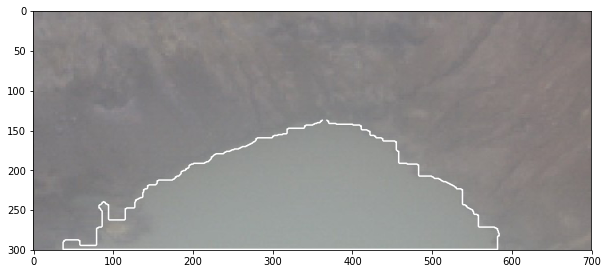

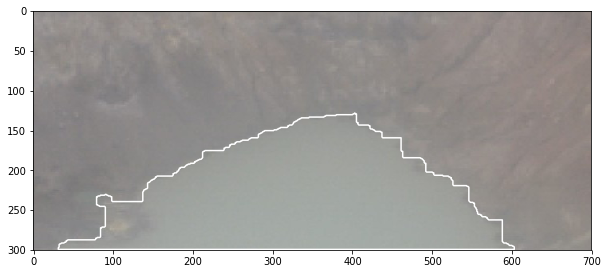

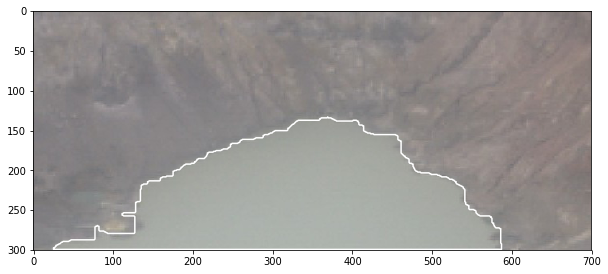

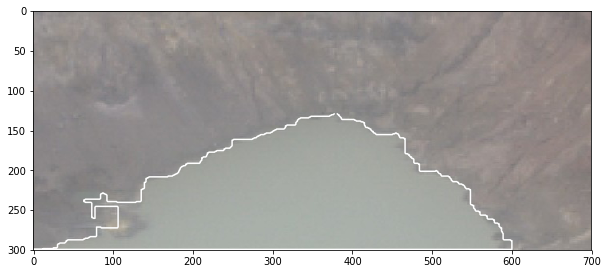

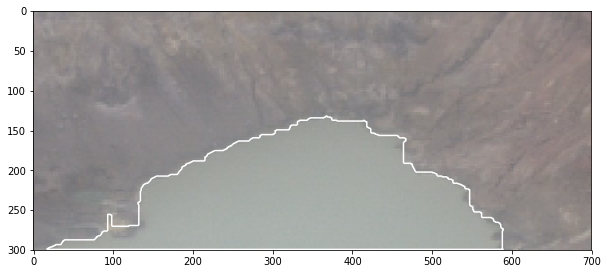

...

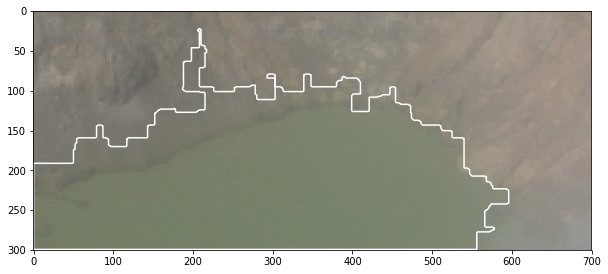

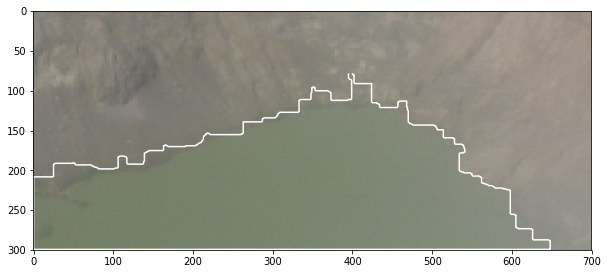

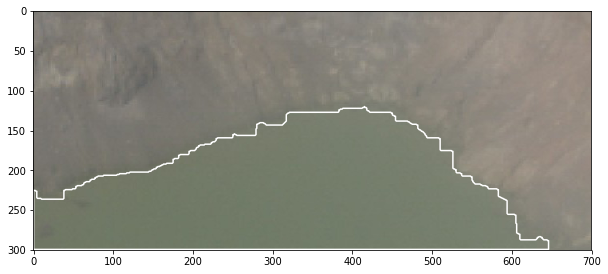

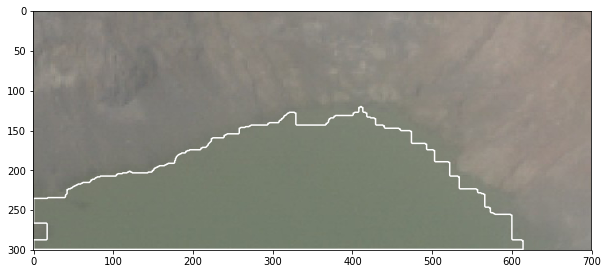

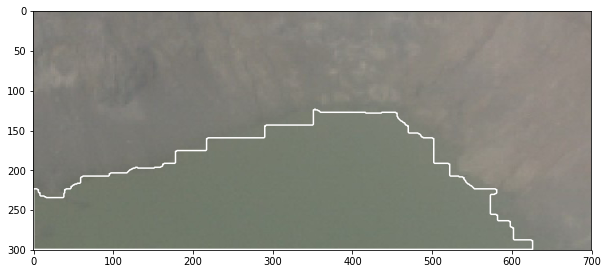

In [10]:
lake = pd.DataFrame()

for file in sorted(os.listdir(imgdir)):
    if file.endswith('.jpg'):
        print (file)
        imtime = imfdt(file)
        imfile = os.path.join(imgdir, file)
        base = os.path.splitext(file)[0]
        target = cv2.imread(imfile)
        
        #dimension of image, number pixels
        dim = target.shape[0]*target.shape[1]
        drop = False
        
        #initialise previous area
        l_area = 0
        l_result = 0
        area = 0
        
        #convert target image to hsv (hue, saturation, value)
        hsvt = cv2.cvtColor(target,cv2.COLOR_BGR2HSV)

        for niter in range(maxiter):
            if niter == 0:
                #crop area
                xmin = x1
                xmax = x2
                ymin = y1
                ymax = y2
                area, result = bproj(target, xmin, xmax, ymin, ymax) #back projection
                print ('iter = ', niter, ' area = ', area)
                #area too large a proportion of full image
                if (area > dim*maxdim):
                    print ('**area too large**')
                    drop = True
                    break
                #previous results
                l_area = area
                l_result = result
            else:
                #subsequent iterations
                
                #make mask from previous estimate gray scale
                mask = cv2.cvtColor(result, cv2.COLOR_BGR2GRAY)

                #largest inner rectangle from mask
                (ymin, xmin, ymax, xmax, x_width, y_width) = innerrect(mask)

                area, result = bproj(target, xmin, xmax, ymin, ymax) #back projection
                print ('iter = ', niter, ' area = ', area)
                #area too large a proportion of full image then break
                if (area > dim*maxdim):
                    print ('**area too large, ignoring this image**')
                    drop = True
                    break
                
                print ('area ratio = {:4.2f}'.format(area/l_area))
                #if area increases to much a blowup, backup and break
                if (area/l_area >= maxinc)or(area/l_area <= 1):
                    print ('**backing up**')
                    area = l_area
                    result = l_result
                    print ('iter = ', niter-1, ' area = ', area)
                    break

                #previous results
                l_area = area
                l_result = result
                print (area, l_area)
        
        print()
        
        if (not drop):
            print ('adding to dataframe')
            lake.index.name = 'iteration'
            ht = plotonimg(result)
            
            #data into a dataframe
            d = {'area':area, 'height':ht}
            df = pd.DataFrame(d, index=[imtime])
            lake = lake.append(df)

In [11]:
lake.head()

,area,height
2018-03-01 00:20:02+00:00,54697.0,145.777778
2018-03-01 00:50:02+00:00,59253.0,134.363636
2018-03-02 00:20:02+00:00,56442.0,144.000000
2018-03-02 00:40:02+00:00,59067.0,137.761905
2018-03-02 00:50:02+00:00,57015.0,139.777778


In [12]:
lake.to_csv('lake.csv')

**plot and height vs time**

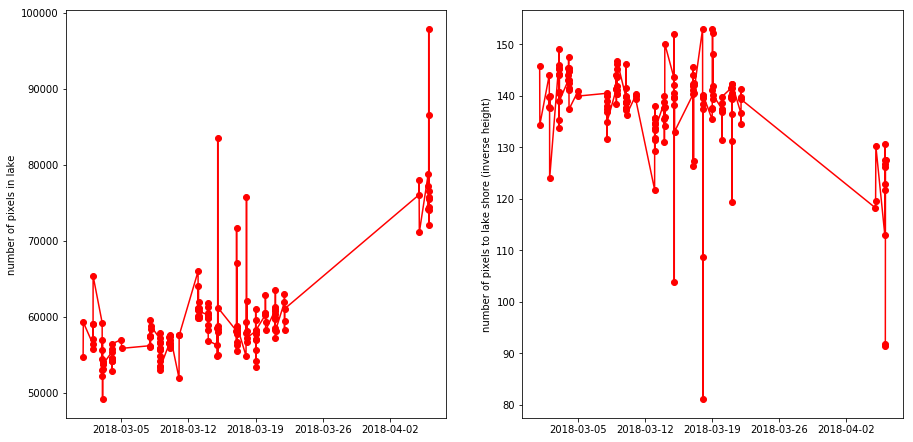

In [13]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15,7.5))
ax1.plot(lake.index, lake.area, marker='o', color='red')
ax1.set_ylabel('number of pixels in lake')

ax2.plot(lake.index, lake.height, marker='o', color='red')
ax2.set_ylabel('number of pixels to lake shore (inverse height)')
plt.savefig('area_height.png')

In [14]:
lakeday = lake.resample('D')
maximum = lakeday.area.max()
minimum = lakeday.area.min()
mean = lakeday.area.mean()
q25 = lakeday.apply(lambda x: x.area.quantile(0.25))
q75 = lakeday.apply(lambda x: x.area.quantile(0.75))

**plot area vs time**

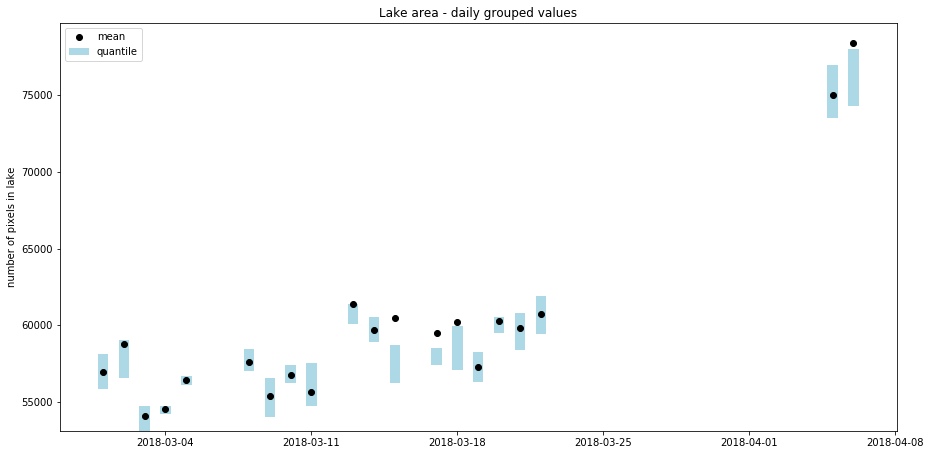

In [16]:
fig,ax = plt.subplots(figsize=(15,7.5))
ax.bar(q25.index, q75-q25, bottom=q25, width = 0.5, align='center', color='lightblue', label='quantile')
ax.plot(mean.index, mean, marker='o', color='black', linestyle='None', label='mean')
#ax.plot(maximum.index, maximum, marker='o', color='red', label='maximum')

ax.set_ylabel('number of pixels in lake')
ax.set_title('Lake area - daily grouped values')
plt.legend(loc='best')
plt.savefig('lakearea_daygroup.png')